In [2]:
# LIBRAIRIES IMPORT
# Data
import pandas as pd
import numpy as np
from sklearn.cluster import KMeans 

# Visualisation
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as colors
import seaborn as sns
import folium
# Metrics
from sklearn import metrics

# Elbow
from yellowbrick.cluster import KElbowVisualizer

In [3]:
data= pd.read_csv(r"C:\Users\rana_\OneDrive\Bureau\Final project\data.csv")

In [4]:
data

,Unnamed: 0,Code du département,Code de la commune,Libellé de la commune,Inscrits,Abstentions,Votants,Blancs,Nuls,Exprimés,...,Sexe,Voix,% Voix/Ins,% Voix/Exp,Code Officiel EPCI,Nom Officiel EPCI,Code Officiel Région,Name,latitude,longitude
0,0,55.0,55535.0,Vaudoncourt,44,11,33,0,0,33,...,1,3,6.82,"9,09",200066173.0,CC de Damvillers Spincourt,44.0,11,49.317453,5.647972
1,1,55.0,55535.0,Vaudoncourt,44,11,33,0,0,33,...,1,5,11.36,"15,15",200066173.0,CC de Damvillers Spincourt,44.0,4,49.317453,5.647972
2,2,55.0,55535.0,Vaudoncourt,44,11,33,0,0,33,...,0,1,2.27,"3,03",200066173.0,CC de Damvillers Spincourt,44.0,9,49.317453,5.647972
3,3,55.0,55545.0,Verdun,808,329,479,17,3,459,...,1,8,0.99,"1,74",200049187.0,CA du Grand Verdun,44.0,8,49.160479,5.378136
4,4,55.0,55545.0,Verdun,1318,499,819,14,5,800,...,1,25,1.90,"3,13",200049187.0,CA du Grand Verdun,44.0,2,49.150832,5.400586
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
724003,836263,62.0,62796.0,Simencourt,459,78,381,6,3,372,...,0,7,1.53,"1,88",200069482.0,CC des Campagnes de l'Artois,32.0,0,50.258141,2.643003
724004,836264,62.0,62801.0,Souchez,1205,299,906,9,2,895,...,0,25,2.07,"2,79",246200364.0,CA de Lens - Liévin,32.0,0,50.391562,2.742967
724005,836265,62.0,62803.0,Surques,440,75,365,6,4,355,...,1,13,2.95,"3,66",246201016.0,CC du Pays de Lumbres,32.0,3,50.742017,1.919849
724006,836266,62.0,62803.0,Surques,440,75,365,6,4,355,...,1,9,2.05,"2,54",246201016.0,CC du Pays de Lumbres,32.0,7,50.742017,1.919849


In [5]:
data.drop(['Unnamed: 0'], axis = 1, inplace=True)

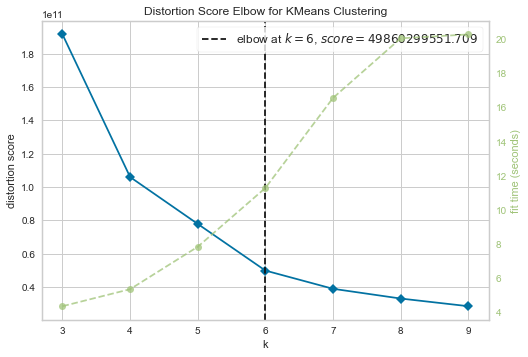

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [6]:
X = data[[ 'Inscrits', 'Abstentions', 'Votants', 'Blancs', 'Nuls', 'Exprimés','Name','Voix']]
model = KMeans(random_state=42)
visualizer = KElbowVisualizer(estimator = model, k = (3,10))
visualizer.fit(X)
visualizer.poof()

In [7]:
# MODEL FITTING
model = KMeans(n_clusters=6, random_state=42 )
model.fit(X)


KMeans(n_clusters=6, random_state=42)

In [8]:
# MODEL PREDICTION
X_predict = X.copy()
X_predict['cluster'] = model.fit_predict(X)
X_predict.cluster.value_counts()

0    265139
1    243516
5    215185
4       132
2        24
3        12
Name: cluster, dtype: int64

In [9]:
from sklearn import metrics

In [10]:
# SCORING

n_clusters = len(X_predict.cluster.unique())
labels = model.labels_

print(f'Estimated number of clusters: {n_clusters:d}')
print(f'Silhouette Score: {metrics.silhouette_score(X, labels, metric="sqeuclidean", random_state=42, sample_size = 10000):0.3f}')
print(f'Calinski-Harabasz Score: {metrics.calinski_harabasz_score(X, labels):.0f}')
print(f'Davies-Bouldin Score: {metrics.davies_bouldin_score(X, labels):0.3f}')

Estimated number of clusters: 6
Silhouette Score: 0.677
Calinski-Harabasz Score: 1689565
Davies-Bouldin Score: 0.508


In [11]:
X_predict

,Inscrits,Abstentions,Votants,Blancs,Nuls,Exprimés,Name,Voix,cluster
0,44,11,33,0,0,33,11,3,1
1,44,11,33,0,0,33,4,5,1
2,44,11,33,0,0,33,9,1,1
3,808,329,479,17,3,459,8,8,0
4,1318,499,819,14,5,800,2,25,5
...,...,...,...,...,...,...,...,...,...
724003,459,78,381,6,3,372,0,7,1
724004,1205,299,906,9,2,895,0,25,5
724005,440,75,365,6,4,355,3,13,1
724006,440,75,365,6,4,355,7,9,1


In [24]:
X_predict.cluster.value_counts()

0    265139
1    243516
5    215185
4       132
2        24
3        12
Name: cluster, dtype: int64

In [16]:
data_map = pd.concat([X_predict, data['latitude'], data['longitude']], axis = 1)

In [17]:
data_map

,Inscrits,Abstentions,Votants,Blancs,Nuls,Exprimés,Name,Voix,cluster,latitude,longitude
0,44,11,33,0,0,33,11,3,1,49.317453,5.647972
1,44,11,33,0,0,33,4,5,1,49.317453,5.647972
2,44,11,33,0,0,33,9,1,1,49.317453,5.647972
3,808,329,479,17,3,459,8,8,0,49.160479,5.378136
4,1318,499,819,14,5,800,2,25,5,49.150832,5.400586
...,...,...,...,...,...,...,...,...,...,...,...
724003,459,78,381,6,3,372,0,7,1,50.258141,2.643003
724004,1205,299,906,9,2,895,0,25,5,50.391562,2.742967
724005,440,75,365,6,4,355,3,13,1,50.742017,1.919849
724006,440,75,365,6,4,355,7,9,1,50.742017,1.919849


In [30]:
# Initialise map (centered on mean)
map_clusters = folium.Map(location=[data_map.latitude.mean(), data_map.longitude.mean()],
                zoom_start=9, control_scale=False, zoom_control = True, scrollWheelZoom=False, dragging=False)

# Number of points to show
nb_points = 20000
df_map = data_map.sample(frac = nb_points/data_map.shape[0], random_state=42)


# set color scheme for the clusters
x = np.arange(6)
ys = [i + x + (i*x)**2 for i in range(5)]
#colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lng, cluster in zip(df_map['latitude'], df_map['longitude'], df_map['cluster']):
    folium.vector_layers.CircleMarker(
        [lat, lng],
        radius=5,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.9,
        stroke = False).add_to(map_clusters)
    

      
map_clusters

In [36]:
nb_points = 20000
df_map= data_map.sample(frac = nb_points/data_map.shape[0], random_state=42)
df_map.cluster.value_counts()
df_map1=df_map.loc[df_map["cluster"]==0]
df_map1

,Inscrits,Abstentions,Votants,Blancs,Nuls,Exprimés,Name,Voix,cluster,latitude,longitude
124182,861,142,719,13,6,700,0,6,0,47.215583,-1.333671
441450,853,220,633,5,2,626,11,55,0,45.160568,5.743699
664253,620,143,477,11,3,463,10,8,0,49.912035,1.121115
685417,827,191,636,8,1,627,3,16,0,48.903300,4.005603
571657,680,193,487,10,6,471,3,20,0,46.842067,3.458806
...,...,...,...,...,...,...,...,...,...,...,...
589546,735,385,350,5,12,333,3,2,0,16.170089,-61.602740
547880,878,417,461,5,8,448,2,2,0,-20.999763,55.327503
143470,702,209,493,10,0,483,4,117,0,48.406435,-4.497736
211292,857,226,631,5,1,625,8,4,0,43.142942,5.755920


In [39]:
# Initialise map (centered on mean)
map_clusters = folium.Map(location=[data_map.latitude.mean(), data_map.longitude.mean()],
                zoom_start=9, control_scale=False, zoom_control = True, scrollWheelZoom=False, dragging=False)

In [40]:
# Number of points to show


#colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lng, cluster in zip(df_map1['latitude'], df_map1['longitude'], df_map1['cluster']):
    folium.vector_layers.CircleMarker(
        [lat, lng],
        radius=5,
        #color=rainbow[cluster-1],
        fill=True,
        #fill_color=rainbow[cluster-1],
        fill_opacity=0.9,
        stroke = False).add_to(map_clusters)
    

      
map_clusters